<a href="https://colab.research.google.com/github/jzyee/pd_pose_2_UDysRS/blob/master/PD_VGG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!pip install -qq tf-nightly-gpu-2.0-preview

     |████████████████████████████████| 369.2MB 55kB/s 
     |████████████████████████████████| 460kB 41.6MB/s 
     |████████████████████████████████| 61kB 22.3MB/s 
     |████████████████████████████████| 3.9MB 33.4MB/s 


# checking for GPU

In [0]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


# Background

> info for dataset: 
https://github.com/limi44/Parkinson-s-Pose-Estimation-Dataset

> link to actual dataset: http://individual.utoronto.ca/BabakTaati/Data/PD/UDysRS_UPDRS_Export.zip

> my feature processing to spectrograms: https://colab.research.google.com/drive/1zbaEcpc-D-vSORrT4JIciQFupwG6WJA2



The original dataset includes all movement trajectories extracted from the videos of Parkinson's assessments using Convolutional Pose Machines (CPM) (https://arxiv.org/abs/1602.00134),

There are several kinds task environments the assessments were taken in. The position of joints such as ankle,elbow,shoulder and wrist have been recorded for each assesment. 

For **this project** we will focus on the tremors of the **right wrist** of PD patients in the **communication task**.


The features
> I have preprocessed the original dataset into corresponding spectrograms. Each spectrogram is made up of 2 parts. The left side is the horizontal position converted into a spectrogram and the right side is the vertical position converted into a spectrogram. I then merge the two spectrograms to form a combined image.

The labels

> The UDysRS is a metric to measure how significant the tremors   are. Typically the tremors are measured in-person. 


The goal

>The goal will be to classify the severity of parkinsonism and dyskinesia recorded tremors into UDysRS score with transfer learning

Why

> The idea could be the basis of an app. Where the patient could conduct the assesment anywhere with his/her smartphone. The patient would hold his/her smart phone and the phone would record the positional data, the phone would then use a deep learning model to classify the recorded tremors to a UDysRS score. With easier access to the classification of the tremors, patients and doctors will be able to identify earlier if medication is working.


# Loading dataset

In [0]:
import sys
try:
    import ujson as json
except ImportError:
    try:
        import simplejson as json
    except ImportError:
        import json

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import scipy
from sklearn.preprocessing import MinMaxScaler
import pywt
import os
from PIL import Image
# import tensorflow as tf
from glob import glob

from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.models import Model,load_model,Sequential

from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout,Flatten, Input
from tensorflow.keras import backend as K


In [0]:
from google.colab import drive
drive.mount('/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /gdrive


## Dataset classes

In [0]:
img_path = '/gdrive/My Drive/PD_images'
! dir '/gdrive/My Drive/PD_images'

0  1  2


There are 3 classes signifying the UDysRS score. The typical score range is 0 - 4. However as we are looking at the communication trials, there are no recorded instances of wrist dyskinesias causing severe problems while communicating. So the range we are looking at for this instance is 0 - 2.

In [0]:
df = {}
data = []
for x in os.listdir(img_path):
  if x.isdigit():
    for pic in os.listdir(img_path+'/'+str(x)):
      data.append((img_path+ '/' + x + '/' + pic , x))

df = pd.DataFrame(data, columns=['filename', 'class'])
df['class'] = df['class'].astype(int)
#shuffle
df = df.sample(frac=1).reset_index(drop=True)

print(df.head())
print(len(df))
df.dtypes

                                 filename  class
0  /gdrive/My Drive/PD_images/0/267-2.png      0
1  /gdrive/My Drive/PD_images/0/259-2.png      0
2   /gdrive/My Drive/PD_images/0/50-1.png      0
3  /gdrive/My Drive/PD_images/2/238-3.png      2
4   /gdrive/My Drive/PD_images/2/83-2.png      2
156


filename    object
class        int64
dtype: object

## Breakdown on the classes

In [0]:
from collections import Counter
cnt = Counter(df['class'])
cnt

Counter({0: 73, 1: 31, 2: 52})

73 samples of class 0

31 samples of class 1

52 samples of class 2

## Splitting into train and validation sets

In [0]:
# Split into train and validation sets
train_set_percentage = .7


df = df[:int(len(df)*train_set_percentage)]
df_val = df[int(len(df)*train_set_percentage):]

# shuffle 
df = df.sample(frac=1).reset_index(drop=True)
df_val = df_val.sample(frac=1).reset_index(drop=True)

In [0]:
!wget -qq http://individual.utoronto.ca/BabakTaati/Data/PD/UDysRS_UPDRS_Export.zip
!unzip UDysRS_UPDRS_Export.zip
pd_path = 'UDysRS_UPDRS_Export/'
trajectory_file = pd_path + 'Communication_all_export.txt'

with open(trajectory_file, 'r') as infile:
    comm_dict = json.load(infile)

Archive:  UDysRS_UPDRS_Export.zip
   creating: UDysRS_UPDRS_Export/
   creating: UDysRS_UPDRS_Export/.ipynb_checkpoints/
  inflating: UDysRS_UPDRS_Export/.ipynb_checkpoints/data_import_demo-checkpoint.ipynb  
  inflating: UDysRS_UPDRS_Export/CAPSIT.txt  
  inflating: UDysRS_UPDRS_Export/Communication_all_export.txt  
  inflating: UDysRS_UPDRS_Export/data_import_demo.ipynb  
  inflating: UDysRS_UPDRS_Export/Drinking_all_export.txt  
  inflating: UDysRS_UPDRS_Export/LA_split_all_export.txt  
  inflating: UDysRS_UPDRS_Export/LICENSE.txt  
  inflating: UDysRS_UPDRS_Export/sn_numbers.txt  
  inflating: UDysRS_UPDRS_Export/TT_opt_flow_export.txt  
  inflating: UDysRS_UPDRS_Export/UDysRS.txt  
  inflating: UDysRS_UPDRS_Export/UPDRS.txt  


## Example of the data


The raw data that can be seen below is made up of two parts:
- horizontal positions
- vertical positions

The position values are plotted against time in seconds

The horizontal position values and vertical position values are then converted into a spectrogram respectively. Then the spectrograms are combined side by side with horizontal position spectrogram on the left and the vertical position spectrogram on the right.

The image conversion process was done in the following notebook:
https://colab.research.google.com/drive/1zbaEcpc-D-vSORrT4JIciQFupwG6WJA2

### class 0 example

retreiving the first instance of class 0

In [0]:
#first instance of class zero
instance_0_filename = df.loc[df['class'] == 0].iloc[0,:]['filename']
instance_0_key = instance_0_filename.split('/')[-1].split('.')[0]
print(instance_0_filename)
instance_0_key + ' is the key that is being used for this example'

/gdrive/My Drive/PD_images/0/50-1.png


'50-1 is the key that is being used for this example'

#### Raw data

In [0]:
def plot_raw_data(instance_key):
  fig, ax = plt.subplots(nrows=1, ncols=2)
  fig.set_figheight(8)
  fig.set_figwidth(10)
  #raw data
  plt.subplot(221)
  plt.plot(np.array(comm_dict[instance_key]['position']['Rwri'])[:,0])
  plt.subplot(222)
  plt.plot(np.array(comm_dict[instance_key]['position']['Rwri'])[:,1])
  plt.show()

The following figue shows raw postion data. The horizontal position data on the left and the vertical position data on the right

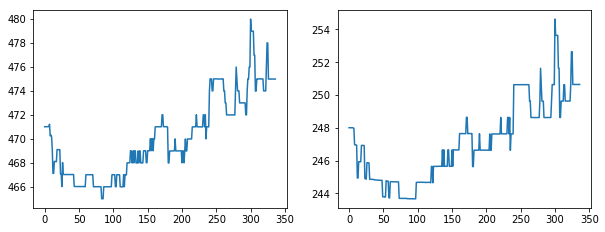

In [0]:
plot_raw_data(instance_0_key)

In [0]:
import numpy as np
import matplotlib.pyplot as plt

from matplotlib import animation, rc
from IPython.display import HTML

def plot_raw_moving(instance_key):
  horizontal_data = np.array(comm_dict[instance_key]['position']['Rwri'])[:,0]
  vertical_data = np.array(comm_dict[instance_key]['position']['Rwri'])[:,1]

  vert_min = min(vertical_data) - 5
  vert_max = max(vertical_data) + 5

  hori_min = min(horizontal_data) - 5
  hori_max = max(horizontal_data) + 5
  # First set up the figure, the axis, and the plot element we want to animate
  fig, ax = plt.subplots(2,2)
  plt.close()

  fig.suptitle('Breakdown of wrist position into horizontal and vertical', fontsize=12)

  ax[0,0].set_xlim(( 0, 50))
  ax[0,0].set_ylim((vert_min, vert_max))
  ax[0,0].set_ylabel('vertical position')

  ax[0,1].set_xlim((hori_min, hori_max))
  ax[0,1].set_ylim((vert_min, vert_max))
  ax[0,1].set_title('Representation of wrist position')

  ax[1,1].set_xlim((hori_min, hori_max))
  ax[1,1].set_ylim(( 0, 50))
  ax[1,1].set_xlabel('horizontal position')


  line, = ax[0,0].plot([], [], lw=2)
  line2, = ax[1,1].plot([], [], lw=2)
  mov_point, = ax[0,1].plot([],[], 'o')

  # initialization function: plot the background of each frame
  def init():
      line.set_data([], [])
      line2.set_data([], [])
      mov_point.set_data([], [])
      return (line, line2, mov_point)

  # animation function. This is called sequentially  
  def animate(i):
      #x = np.linspace(0, len(horizontal_data),len(horizontal_data)/5)
      #y = np.array(horizontal_data[5*i:5*i+5])
      line.set_data(list(range(50)),np.array(vertical_data[i:i+50]))
      line2.set_data(np.array(horizontal_data[i:i+50]), list(range(50)))
      mov_point.set_data(horizontal_data[50+i], vertical_data[50+i])
      return (line, line2, mov_point)


  anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=100, blit=True)
  return anim

# Note: below is the part which makes it work on Colab
rc('animation', html='jshtml')
plot_raw_moving(instance_0_key)
  

To view the video, press the play button. The above video shows how the horizontal and vertical positions correpsond to the actual wrist position during recording

#### Processed to Spectrogram

As mention in the background section, the features have already been converted to spectrogram images in another file:  https://colab.research.google.com/drive/1zbaEcpc-D-vSORrT4JIciQFupwG6WJA2



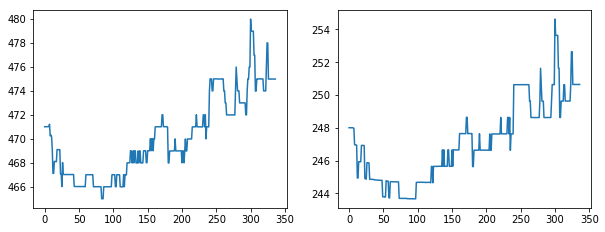

(670, 218)


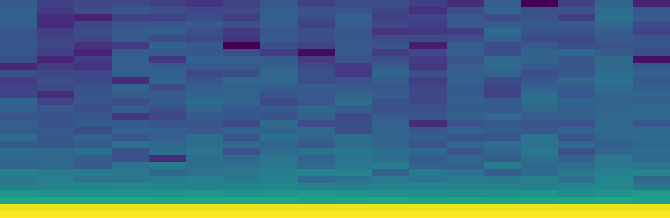

In [0]:
from PIL import Image

plot_raw_data(instance_0_key)

im = Image.open(instance_0_filename)
print(im.size)
im

The following image is a spectrogram corresonding to a UDysRs score of 0

The above image is a combination of two spectrograms. The spectrogram are made from the raw data that can be seen above. The left being the horizontal data and the right being the vertical data. 

### class 1 example

In [0]:
#first instance of class one
instance_1_filename = df.loc[df['class'] == 1].iloc[0,:]['filename']
instance_1_key = instance_1_filename.split('/')[-1].split('.')[0]
print(instance_1_filename)
instance_1_key + ' is the key that is being used for this example'

/gdrive/My Drive/PD_images/1/274-2.png


'274-2 is the key that is being used for this example'

#### Raw data

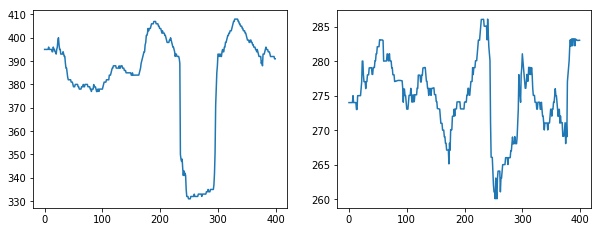

In [0]:
plot_raw_data(instance_1_key)

It can be observed that the position recordings have more sharp fluctuations than class 0.

In [0]:
plot_raw_moving(instance_1_key)

#### Processed to Spectrogram

The following image is a spectrogram corresonding to a UDysRs score of 1

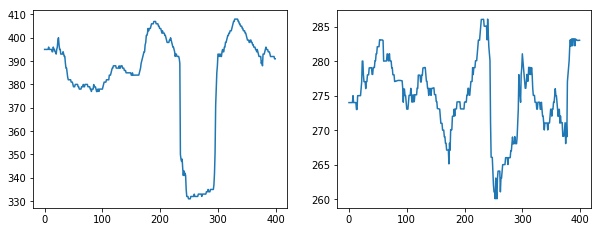

(670, 218)


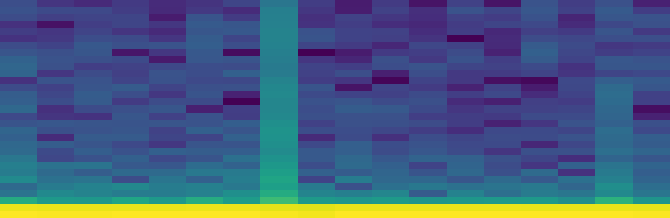

In [0]:
plot_raw_data(instance_1_key)
im = Image.open(instance_1_filename)
print(im.size)
im

The following image is a spectrogram corresonding to a UDysRs score of 1

The above image is a combination of two spectrograms. The spectrogram are made from the raw data that can be seen above. The left being the horizontal data and the right being the vertical data. 

### class 2 example

In [0]:
#first instance of class two
instance_2_filename = df.loc[df['class'] == 2].iloc[0,:]['filename']
instance_2_key = instance_2_filename.split('/')[-1].split('.')[0]
print(instance_2_filename)
instance_2_key + ' is the key that is being used for this example'

/gdrive/My Drive/PD_images/2/8-1.png


'8-1 is the key that is being used for this example'

#### Raw data

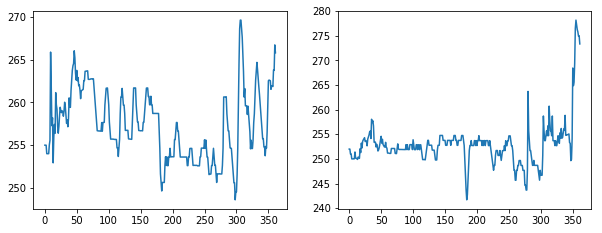

In [0]:
plot_raw_data(instance_2_key)

It can be observed that there are even more fluctuations or more 'zig-zag' behavior in class 2 as compared to class 1

In [0]:
plot_raw_moving(instance_2_key)

#### Processed to Spectrogram

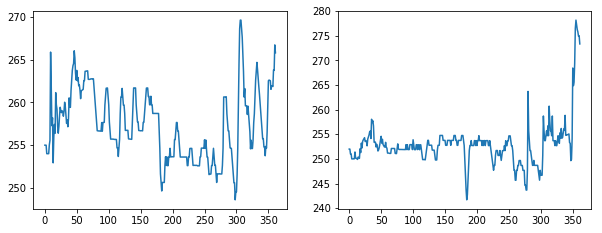

(670, 218)


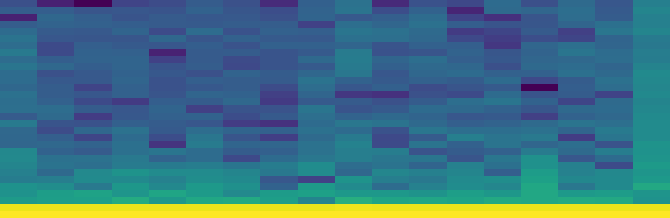

In [0]:
plot_raw_data(instance_2_key)
im = Image.open(instance_2_filename)
print(im.size)
im

The following image is a spectrogram corresonding to a UDysRs score of 2

The above image is a combination of two spectrograms. The spectrogram are made from the raw data that can be seen above. The left being the horizontal data and the right being the vertical data. 

## Make pipeline for loading and resizing images

In [0]:
# Reads an image from a file, decodes it into a tensor, and resizes it
# to a fixed shape.
img_rows, img_cols = 200,200
num_classes = len(set(df['class']))
batch_size = 10

def _parse_function(filename, label):
  image_string = tf.io.read_file(filename)
  image_decoded = tf.image.decode_jpeg(image_string)
  image_resized = tf.image.resize(image_decoded, [img_rows, img_cols])
  image_resized = tf.ensure_shape(image_resized ,shape=(img_rows, img_cols,3))
  label = tf.one_hot(label, num_classes)
  return image_resized, label

# Assembling the data  pipeline using tf.data

In [0]:
train_dataset = tf.data.Dataset.from_tensor_slices((tf.cast(df['filename'].values, tf.string),
                                                    tf.cast(df['class'].values, tf.int32) ))
train_dataset = train_dataset.map(_parse_function)
train_dataset = train_dataset.shuffle(5000)
train_dataset = train_dataset.repeat()
train_dataset = train_dataset.batch(batch_size, drop_remainder=True)

In [0]:
valid_dataset = tf.data.Dataset.from_tensor_slices((tf.cast(df_val['filename'].values, tf.string),
                                                    tf.cast(df_val['class'].values, tf.int32) ))
valid_dataset = valid_dataset.map(_parse_function)
valid_dataset = valid_dataset.shuffle(5000)
valid_dataset = valid_dataset.repeat()
valid_dataset = valid_dataset.batch(batch_size, drop_remainder=True)

In [0]:
train_dataset

<BatchDataset shapes: ((10, 200, 200, 3), (10, 3)), types: (tf.float32, tf.float32)>

#VGG

## Loading VGG-16

In [0]:
# create the base pre-trained model
base_vgg = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=(200, 200, 3),pooling=None)

58892288/58889256 [==============================] - 1s 0us/step


In [0]:
base_vgg.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 200, 200, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 200, 200, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 200, 200, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 100, 100, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 100, 100, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 100, 100, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 50, 50, 128)       0     

## Modifying VGG-16

In [0]:
# add a global spatial average pooling layer
x = base_vgg.output

x = GlobalAveragePooling2D()(x)

# let's add a fully-connected layer
x = Dense(512, activation='relu')(x)

# x = Dropout(0.3)(x)

# and a logits layer -- let's say we have 3 classes
predictions = Dense(3, activation='softmax')(x)


In [0]:
# this is the model we will train
base_vgg_model = Model(inputs=base_vgg.input, outputs=predictions)

In [0]:
for layer in base_vgg_model.layers:
    print(layer.name)
    layer.trainable = False

input_1
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_pool
global_average_pooling2d
dense
dense_1


In [0]:
for layer in base_vgg_model.layers:
    print(layer.name,' Trainable =',layer.trainable)

input_1  Trainable = False
block1_conv1  Trainable = False
block1_conv2  Trainable = False
block1_pool  Trainable = False
block2_conv1  Trainable = False
block2_conv2  Trainable = False
block2_pool  Trainable = False
block3_conv1  Trainable = False
block3_conv2  Trainable = False
block3_conv3  Trainable = False
block3_pool  Trainable = False
block4_conv1  Trainable = False
block4_conv2  Trainable = False
block4_conv3  Trainable = False
block4_pool  Trainable = False
block5_conv1  Trainable = False
block5_conv2  Trainable = False
block5_conv3  Trainable = False
block5_pool  Trainable = False
global_average_pooling2d  Trainable = False
dense  Trainable = False
dense_1  Trainable = False


In [0]:
base_vgg_model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 200, 200, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 200, 200, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 200, 200, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 100, 100, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 100, 100, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 100, 100, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 50, 50, 128)       0     

In [0]:
opt = tf.keras.optimizers.Adam(lr=0.001)

# compile the model (should be done *after* setting layers to non-trainable)
base_vgg_model.compile(optimizer=opt, loss='categorical_crossentropy',metrics=['accuracy'])

In [0]:
train_steps = int(len(df)/10) #total trains set / batch_size
val_steps = int(len(df_val)/10)
epochs = 1

print('train steps:',train_steps)
print('val steps:',val_steps)

train steps: 10
val steps: 3


## 10 epoch test

In [0]:
epochs = 10

### Train the model with validation 
vgg_history = base_vgg_model.fit( train_dataset, steps_per_epoch = train_steps,
                   epochs = epochs,
                   validation_data = valid_dataset,
                   validation_steps = val_steps)

Epoch 1/10
10/10 [==============================] - 26s 3s/step - loss: 1.5589 - accuracy: 0.3000 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 2/10
10/10 [==============================] - 2s 233ms/step - loss: 1.6411 - accuracy: 0.3000 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 3/10
10/10 [==============================] - 2s 232ms/step - loss: 1.6302 - accuracy: 0.2800 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 4/10
10/10 [==============================] - 2s 230ms/step - loss: 1.5263 - accuracy: 0.3300 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 5/10
10/10 [==============================] - 2s 233ms/step - loss: 1.6532 - accuracy: 0.3000 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 6/10
10/10 [==============================] - 2s 230ms/step - loss: 1.5027 - accuracy: 0.3300 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 7/10
10/10 [==============================] - 2s 232ms/step - loss: 1.5724 - accuracy: 0.3300 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 8/

## 10 epoch result

In [0]:
metrics = base_vgg_model.evaluate(valid_dataset,
                   steps = val_steps)
print("model accuracy:",metrics[1])

3/3 [==============================] - 1s 262ms/step - loss: 1.6910 - accuracy: 0.3000
model accuracy: 0.3


Very bad default accuracy, requires tuning

# Tuning VGG-16

## block 5 unfreezed

In [0]:
base_vgg_model.trainable = True

set_trainable = False
for layer in base_vgg_model.layers:
    if layer.name == 'block5_conv1':
        set_trainable = True
    if set_trainable:
        layer.trainable = True
    else:
        layer.trainable = False

In [0]:
for layer in base_vgg_model.layers:
    print(layer.name,layer.trainable)

input_1 False
block1_conv1 False
block1_conv2 False
block1_pool False
block2_conv1 False
block2_conv2 False
block2_pool False
block3_conv1 False
block3_conv2 False
block3_conv3 False
block3_pool False
block4_conv1 False
block4_conv2 False
block4_conv3 False
block4_pool False
block5_conv1 True
block5_conv2 True
block5_conv3 True
block5_pool True
global_average_pooling2d True
dense True
dense_1 True


In [0]:
from tensorflow.keras.callbacks import EarlyStopping

epochs = 500

	
es = EarlyStopping(monitor='accuracy', mode='max', verbose=1, patience=50)

# Train the model with validation 
tuned_vgg_history = base_vgg_model.fit( train_dataset, steps_per_epoch = train_steps,
                   epochs = epochs,
                   validation_data = valid_dataset,
                   validation_steps = val_steps,
                   callbacks=[es])

Epoch 1/500


W0714 22:45:22.031477 139693731596160 training.py:1949] Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?


10/10 [==============================] - 4s 352ms/step - loss: 1.5589 - accuracy: 0.3000 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 2/500
10/10 [==============================] - 2s 232ms/step - loss: 1.6411 - accuracy: 0.3000 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 3/500
10/10 [==============================] - 2s 232ms/step - loss: 1.6302 - accuracy: 0.2800 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 4/500
10/10 [==============================] - 2s 231ms/step - loss: 1.5263 - accuracy: 0.3300 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 5/500
10/10 [==============================] - 2s 232ms/step - loss: 1.6532 - accuracy: 0.3000 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 6/500
10/10 [==============================] - 2s 233ms/step - loss: 1.5027 - accuracy: 0.3300 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 7/500
10/10 [==============================] - 2s 230ms/step - loss: 1.5724 - accuracy: 0.3300 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 8/500

In [0]:
metrics = base_vgg_model.evaluate(valid_dataset,
                   steps = val_steps)
print("model accuracy:",metrics[1])

3/3 [==============================] - 1s 275ms/step - loss: 1.6910 - accuracy: 0.3000
model accuracy: 0.3


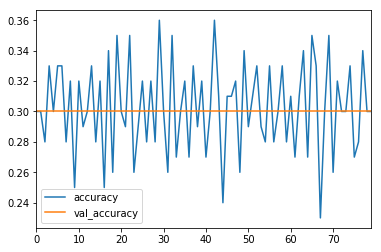

In [0]:
pd.DataFrame(tuned_vgg_history.history)[['accuracy','val_accuracy']].plot()

## block 4 unfreezed

In [0]:
base_vgg_model.trainable = True

set_trainable = False
for layer in base_vgg_model.layers:
    if layer.name == 'block4_conv1':
        set_trainable = True
    if set_trainable:
        layer.trainable = True
    else:
        layer.trainable = False

In [0]:
for layer in base_vgg_model.layers:
    print(layer.name,layer.trainable)

input_1 False
block1_conv1 False
block1_conv2 False
block1_pool False
block2_conv1 False
block2_conv2 False
block2_pool False
block3_conv1 False
block3_conv2 False
block3_conv3 False
block3_pool False
block4_conv1 True
block4_conv2 True
block4_conv3 True
block4_pool True
block5_conv1 True
block5_conv2 True
block5_conv3 True
block5_pool True
global_average_pooling2d True
dense True
dense_1 True


In [0]:
epochs = 500

	
es = EarlyStopping(monitor='accuracy', mode='max', verbose=1, patience=50)

# Train the model with validation 
tuned_vgg_2_history = base_vgg_model.fit( train_dataset, steps_per_epoch = train_steps,
                   epochs = epochs,
                   validation_data = valid_dataset,
                   validation_steps = val_steps,
                   callbacks=[es])

Epoch 1/500
10/10 [==============================] - 4s 355ms/step - loss: 1.5589 - accuracy: 0.3000 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 2/500
10/10 [==============================] - 2s 230ms/step - loss: 1.6411 - accuracy: 0.3000 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 3/500
10/10 [==============================] - 2s 229ms/step - loss: 1.6302 - accuracy: 0.2800 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 4/500
10/10 [==============================] - 2s 231ms/step - loss: 1.5263 - accuracy: 0.3300 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 5/500
10/10 [==============================] - 2s 229ms/step - loss: 1.6532 - accuracy: 0.3000 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 6/500
10/10 [==============================] - 2s 230ms/step - loss: 1.5027 - accuracy: 0.3300 - val_loss: 1.6910 - val_accuracy: 0.3000
Epoch 7/500
10/10 [==============================] - 2s 230ms/step - loss: 1.5724 - accuracy: 0.3300 - val_loss: 1.6910 - val_accuracy: 0.3000

In [0]:
metrics = base_vgg_model.evaluate(valid_dataset,
                   steps = val_steps)
print("model accuracy:",metrics[1])

3/3 [==============================] - 1s 261ms/step - loss: 1.6910 - accuracy: 0.3000
model accuracy: 0.3


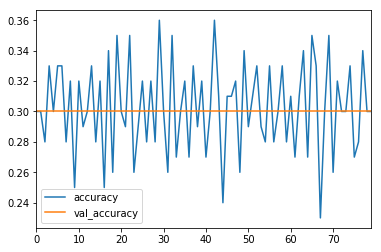

In [0]:
pd.DataFrame(tuned_vgg_2_history.history)[['accuracy','val_accuracy']].plot()

# ResNet

## Loading ResNet50

In [0]:
base_resnet = tf.keras.applications.ResNet50(weights='imagenet', include_top=False, input_shape=(200, 200, 3),pooling=None)

94773248/94765736 [==============================] - 1s 0us/step


## Modifying ResNet50

In [0]:
# add a global spatial average pooling layer
x = base_resnet.output

x = GlobalAveragePooling2D()(x)

# let's add a fully-connected layer
x = Dense(512, activation='relu')(x)

# x = Dropout(0.3)(x)

# and a logits layer -- let's say we have 3 classes
predictions = Dense(3, activation='softmax')(x)

In [0]:
# this is the model we will train
resnet_model = Model(inputs=base_resnet.input, outputs=predictions)

In [0]:
for layer in base_resnet.layers:
    print(layer.name)
    layer.trainable = False

input_2
conv1_pad
conv1_conv
conv1_bn
conv1_relu
pool1_pad
pool1_pool
conv2_block1_1_conv
conv2_block1_1_bn
conv2_block1_1_relu
conv2_block1_2_conv
conv2_block1_2_bn
conv2_block1_2_relu
conv2_block1_0_conv
conv2_block1_3_conv
conv2_block1_0_bn
conv2_block1_3_bn
conv2_block1_add
conv2_block1_out
conv2_block2_1_conv
conv2_block2_1_bn
conv2_block2_1_relu
conv2_block2_2_conv
conv2_block2_2_bn
conv2_block2_2_relu
conv2_block2_3_conv
conv2_block2_3_bn
conv2_block2_add
conv2_block2_out
conv2_block3_1_conv
conv2_block3_1_bn
conv2_block3_1_relu
conv2_block3_2_conv
conv2_block3_2_bn
conv2_block3_2_relu
conv2_block3_3_conv
conv2_block3_3_bn
conv2_block3_add
conv2_block3_out
conv3_block1_1_conv
conv3_block1_1_bn
conv3_block1_1_relu
conv3_block1_2_conv
conv3_block1_2_bn
conv3_block1_2_relu
conv3_block1_0_conv
conv3_block1_3_conv
conv3_block1_0_bn
conv3_block1_3_bn
conv3_block1_add
conv3_block1_out
conv3_block2_1_conv
conv3_block2_1_bn
conv3_block2_1_relu
conv3_block2_2_conv
conv3_block2_2_bn
conv3_

In [0]:
for layer in resnet_model.layers:
    print(layer.name,' Trainable =',layer.trainable)

input_2  Trainable = False
conv1_pad  Trainable = False
conv1_conv  Trainable = False
conv1_bn  Trainable = False
conv1_relu  Trainable = False
pool1_pad  Trainable = False
pool1_pool  Trainable = False
conv2_block1_1_conv  Trainable = False
conv2_block1_1_bn  Trainable = False
conv2_block1_1_relu  Trainable = False
conv2_block1_2_conv  Trainable = False
conv2_block1_2_bn  Trainable = False
conv2_block1_2_relu  Trainable = False
conv2_block1_0_conv  Trainable = False
conv2_block1_3_conv  Trainable = False
conv2_block1_0_bn  Trainable = False
conv2_block1_3_bn  Trainable = False
conv2_block1_add  Trainable = False
conv2_block1_out  Trainable = False
conv2_block2_1_conv  Trainable = False
conv2_block2_1_bn  Trainable = False
conv2_block2_1_relu  Trainable = False
conv2_block2_2_conv  Trainable = False
conv2_block2_2_bn  Trainable = False
conv2_block2_2_relu  Trainable = False
conv2_block2_3_conv  Trainable = False
conv2_block2_3_bn  Trainable = False
conv2_block2_add  Trainable = False
c

In [0]:
opt = tf.keras.optimizers.Adam(lr=0.001)

# compile the model (should be done *after* setting layers to non-trainable)
resnet_model.compile(optimizer=opt, loss='categorical_crossentropy',metrics=['accuracy'])

In [0]:
epochs = 10

### Train the model with validation 
resnet_history = resnet_model.fit( train_dataset, steps_per_epoch = train_steps,
                   epochs = epochs,
                   validation_data = valid_dataset,
                   validation_steps = val_steps)

Epoch 1/10


W0714 22:51:43.583896 139693731596160 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow_core/python/ops/math_grad.py:1251: where (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
W0714 22:51:43.687716 139693731596160 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow_core/python/keras/optimizer_v2/optimizer_v2.py:460: BaseResourceVariable.constraint (from tensorflow.python.ops.resource_variable_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Apply a constraint manually following the optimizer update step.


10/10 [==============================] - 8s 809ms/step - loss: 2.5558 - accuracy: 0.5000 - val_loss: 1.4138 - val_accuracy: 0.6667
Epoch 2/10
10/10 [==============================] - 2s 207ms/step - loss: 1.2184 - accuracy: 0.5700 - val_loss: 1.0164 - val_accuracy: 0.6667
Epoch 3/10
10/10 [==============================] - 2s 209ms/step - loss: 0.8078 - accuracy: 0.7000 - val_loss: 1.0362 - val_accuracy: 0.6667
Epoch 4/10
10/10 [==============================] - 2s 206ms/step - loss: 0.5623 - accuracy: 0.7800 - val_loss: 1.1027 - val_accuracy: 0.6667
Epoch 5/10
10/10 [==============================] - 2s 206ms/step - loss: 0.5031 - accuracy: 0.7500 - val_loss: 1.1138 - val_accuracy: 0.6667
Epoch 6/10
10/10 [==============================] - 2s 208ms/step - loss: 0.4939 - accuracy: 0.8200 - val_loss: 1.1876 - val_accuracy: 0.6667
Epoch 7/10
10/10 [==============================] - 2s 209ms/step - loss: 0.4158 - accuracy: 0.8300 - val_loss: 1.2706 - val_accuracy: 0.6667
Epoch 8/10
10/10 

In [0]:
metrics = resnet_model.evaluate(valid_dataset,
                   steps = val_steps)
print("model accuracy:",metrics[1])

3/3 [==============================] - 1s 243ms/step - loss: 1.2794 - accuracy: 0.6667
model accuracy: 0.6666667


## Tuning ResNet50

In [0]:
resnet_model.trainable = True

set_trainable = False
for layer in resnet_model.layers:
    if layer.name == 'conv5_block1_1_conv':
        set_trainable = True
    if set_trainable:
        layer.trainable = True
    else:
        layer.trainable = False

In [0]:
for layer in resnet_model.layers:
    print(layer.name,' Trainable =',layer.trainable)

input_2  Trainable = False
conv1_pad  Trainable = False
conv1_conv  Trainable = False
conv1_bn  Trainable = False
conv1_relu  Trainable = False
pool1_pad  Trainable = False
pool1_pool  Trainable = False
conv2_block1_1_conv  Trainable = False
conv2_block1_1_bn  Trainable = False
conv2_block1_1_relu  Trainable = False
conv2_block1_2_conv  Trainable = False
conv2_block1_2_bn  Trainable = False
conv2_block1_2_relu  Trainable = False
conv2_block1_0_conv  Trainable = False
conv2_block1_3_conv  Trainable = False
conv2_block1_0_bn  Trainable = False
conv2_block1_3_bn  Trainable = False
conv2_block1_add  Trainable = False
conv2_block1_out  Trainable = False
conv2_block2_1_conv  Trainable = False
conv2_block2_1_bn  Trainable = False
conv2_block2_1_relu  Trainable = False
conv2_block2_2_conv  Trainable = False
conv2_block2_2_bn  Trainable = False
conv2_block2_2_relu  Trainable = False
conv2_block2_3_conv  Trainable = False
conv2_block2_3_bn  Trainable = False
conv2_block2_add  Trainable = False
c

In [0]:
epochs = 500

	
es = EarlyStopping(monitor='accuracy', mode='max', verbose=1, patience=50)

# Train the model with validation 
tuned_resnet_history = resnet_model.fit( train_dataset, steps_per_epoch = train_steps,
                   epochs = epochs,
                   validation_data = valid_dataset,
                   validation_steps = val_steps,
                   callbacks=[es])

Epoch 1/500
10/10 [==============================] - 3s 326ms/step - loss: 0.1718 - accuracy: 0.9800 - val_loss: 1.7075 - val_accuracy: 0.6667
Epoch 2/500
10/10 [==============================] - 2s 209ms/step - loss: 0.2022 - accuracy: 0.9500 - val_loss: 1.4381 - val_accuracy: 0.6667
Epoch 3/500
10/10 [==============================] - 2s 210ms/step - loss: 0.2076 - accuracy: 0.9200 - val_loss: 1.9646 - val_accuracy: 0.6667
Epoch 4/500
10/10 [==============================] - 2s 208ms/step - loss: 0.1371 - accuracy: 0.9700 - val_loss: 1.5317 - val_accuracy: 0.6667
Epoch 5/500
10/10 [==============================] - 2s 207ms/step - loss: 0.1311 - accuracy: 0.9700 - val_loss: 1.5302 - val_accuracy: 0.6667
Epoch 6/500
10/10 [==============================] - 2s 208ms/step - loss: 0.1039 - accuracy: 1.0000 - val_loss: 1.9868 - val_accuracy: 0.6667
Epoch 7/500
10/10 [==============================] - 2s 207ms/step - loss: 0.1568 - accuracy: 0.9400 - val_loss: 1.7893 - val_accuracy: 0.6667

In [0]:
metrics = resnet_model.evaluate(valid_dataset,
                   steps = val_steps)
print("model accuracy:",metrics[1])

3/3 [==============================] - 1s 264ms/step - loss: 2.8927 - accuracy: 0.6667
model accuracy: 0.6666667


# InceptionV3

## loading inception v3

In [0]:
base_inception = tf.keras.applications.InceptionV3(weights='imagenet', include_top=False, input_shape=(200, 200, 3),pooling=None)

87916544/87910968 [==============================] - 2s 0us/step


## modifying inception v3

In [0]:
# add a global spatial average pooling layer
x = base_inception.output

x = GlobalAveragePooling2D()(x)

# let's add a fully-connected layer
x = Dense(512, activation='relu')(x)

# x = Dropout(0.3)(x)

# and a logits layer -- let's say we have 3 classes
predictions = Dense(3, activation='softmax')(x)

In [0]:
inception_model = Model(inputs=base_inception.input, outputs=predictions)

In [0]:
for layer in base_inception.layers:
    print(layer.name)
    layer.trainable = False

input_3
conv2d
batch_normalization
activation
conv2d_1
batch_normalization_1
activation_1
conv2d_2
batch_normalization_2
activation_2
max_pooling2d
conv2d_3
batch_normalization_3
activation_3
conv2d_4
batch_normalization_4
activation_4
max_pooling2d_1
conv2d_8
batch_normalization_8
activation_8
conv2d_6
conv2d_9
batch_normalization_6
batch_normalization_9
activation_6
activation_9
average_pooling2d
conv2d_5
conv2d_7
conv2d_10
conv2d_11
batch_normalization_5
batch_normalization_7
batch_normalization_10
batch_normalization_11
activation_5
activation_7
activation_10
activation_11
mixed0
conv2d_15
batch_normalization_15
activation_15
conv2d_13
conv2d_16
batch_normalization_13
batch_normalization_16
activation_13
activation_16
average_pooling2d_1
conv2d_12
conv2d_14
conv2d_17
conv2d_18
batch_normalization_12
batch_normalization_14
batch_normalization_17
batch_normalization_18
activation_12
activation_14
activation_17
activation_18
mixed1
conv2d_22
batch_normalization_22
activation_22
conv2d

In [0]:
for layer in inception_model.layers:
    print(layer.name,' Trainable =',layer.trainable)

input_3  Trainable = False
conv2d  Trainable = False
batch_normalization  Trainable = False
activation  Trainable = False
conv2d_1  Trainable = False
batch_normalization_1  Trainable = False
activation_1  Trainable = False
conv2d_2  Trainable = False
batch_normalization_2  Trainable = False
activation_2  Trainable = False
max_pooling2d  Trainable = False
conv2d_3  Trainable = False
batch_normalization_3  Trainable = False
activation_3  Trainable = False
conv2d_4  Trainable = False
batch_normalization_4  Trainable = False
activation_4  Trainable = False
max_pooling2d_1  Trainable = False
conv2d_8  Trainable = False
batch_normalization_8  Trainable = False
activation_8  Trainable = False
conv2d_6  Trainable = False
conv2d_9  Trainable = False
batch_normalization_6  Trainable = False
batch_normalization_9  Trainable = False
activation_6  Trainable = False
activation_9  Trainable = False
average_pooling2d  Trainable = False
conv2d_5  Trainable = False
conv2d_7  Trainable = False
conv2d_10 

In [0]:
opt = tf.keras.optimizers.Adam(lr=0.001)

# compile the model (should be done *after* setting layers to non-trainable)
inception_model.compile(optimizer=opt, loss='categorical_crossentropy',metrics=['accuracy'])

In [0]:
epochs = 10

### Train the model with validation 
inception_history = inception_model.fit( train_dataset, steps_per_epoch = train_steps,
                   epochs = epochs,
                   validation_data = valid_dataset,
                   validation_steps = val_steps)

Epoch 1/10
10/10 [==============================] - 104s 10s/step - loss: 2.1804 - accuracy: 0.5000 - val_loss: 12.8945 - val_accuracy: 0.2000
Epoch 2/10
10/10 [==============================] - 4s 394ms/step - loss: 1.5001 - accuracy: 0.5300 - val_loss: 13.9690 - val_accuracy: 0.1333
Epoch 3/10
10/10 [==============================] - 4s 376ms/step - loss: 1.1067 - accuracy: 0.5100 - val_loss: 12.8945 - val_accuracy: 0.2000
Epoch 4/10
10/10 [==============================] - 4s 376ms/step - loss: 1.0401 - accuracy: 0.5600 - val_loss: 13.9690 - val_accuracy: 0.1333
Epoch 5/10
10/10 [==============================] - 4s 383ms/step - loss: 0.9153 - accuracy: 0.5500 - val_loss: 9.8440 - val_accuracy: 0.2000
Epoch 6/10
10/10 [==============================] - 4s 378ms/step - loss: 0.9147 - accuracy: 0.5200 - val_loss: 5.3727 - val_accuracy: 0.6667
Epoch 7/10
10/10 [==============================] - 4s 380ms/step - loss: 0.9234 - accuracy: 0.6100 - val_loss: 5.3727 - val_accuracy: 0.6667
Ep

## tuning inception v3

In [0]:
inception_model.trainable = True

set_trainable = False
for layer in inception_model.layers:
    if layer.name == 'conv2d_77':
        set_trainable = True
    if set_trainable:
        layer.trainable = True
    else:
        layer.trainable = False

In [0]:
for layer in inception_model.layers:
    print(layer.name,' Trainable =',layer.trainable)

input_3  Trainable = False
conv2d  Trainable = False
batch_normalization  Trainable = False
activation  Trainable = False
conv2d_1  Trainable = False
batch_normalization_1  Trainable = False
activation_1  Trainable = False
conv2d_2  Trainable = False
batch_normalization_2  Trainable = False
activation_2  Trainable = False
max_pooling2d  Trainable = False
conv2d_3  Trainable = False
batch_normalization_3  Trainable = False
activation_3  Trainable = False
conv2d_4  Trainable = False
batch_normalization_4  Trainable = False
activation_4  Trainable = False
max_pooling2d_1  Trainable = False
conv2d_8  Trainable = False
batch_normalization_8  Trainable = False
activation_8  Trainable = False
conv2d_6  Trainable = False
conv2d_9  Trainable = False
batch_normalization_6  Trainable = False
batch_normalization_9  Trainable = False
activation_6  Trainable = False
activation_9  Trainable = False
average_pooling2d  Trainable = False
conv2d_5  Trainable = False
conv2d_7  Trainable = False
conv2d_10 

In [0]:
epochs = 500

	
es = EarlyStopping(monitor='accuracy', mode='max', verbose=1, patience=50)

# Train the model with validation 
tuned_inception_history = inception_model.fit( train_dataset, steps_per_epoch = train_steps,
                   epochs = epochs,
                   validation_data = valid_dataset,
                   validation_steps = val_steps,
                   callbacks=[es])

Epoch 1/500
10/10 [==============================] - 5s 511ms/step - loss: 0.5460 - accuracy: 0.8000 - val_loss: 2.9555 - val_accuracy: 0.6667
Epoch 2/500
10/10 [==============================] - 4s 372ms/step - loss: 0.3979 - accuracy: 0.8700 - val_loss: 5.2626 - val_accuracy: 0.6667
Epoch 3/500
10/10 [==============================] - 4s 377ms/step - loss: 0.5139 - accuracy: 0.8500 - val_loss: 1.2984 - val_accuracy: 0.7000
Epoch 4/500
10/10 [==============================] - 4s 371ms/step - loss: 0.2644 - accuracy: 0.9400 - val_loss: 2.0169 - val_accuracy: 0.6667
Epoch 5/500
10/10 [==============================] - 4s 377ms/step - loss: 0.5001 - accuracy: 0.7800 - val_loss: 2.0833 - val_accuracy: 0.6000
Epoch 6/500
10/10 [==============================] - 4s 372ms/step - loss: 0.4284 - accuracy: 0.8200 - val_loss: 2.2561 - val_accuracy: 0.5000
Epoch 7/500
10/10 [==============================] - 4s 373ms/step - loss: 0.4354 - accuracy: 0.8300 - val_loss: 0.5202 - val_accuracy: 0.7000

In [0]:
metrics = inception_model.evaluate(valid_dataset,
                   steps = val_steps)
print("model accuracy:",metrics[1])

3/3 [==============================] - 1s 243ms/step - loss: 0.1227 - accuracy: 0.9667
model accuracy: 0.96666664


# Conclusion

A tuned InceptionV3 got the best results for this dataset

In [0]:
inception_metrics = inception_model.evaluate(valid_dataset,
                   steps = val_steps)
resnet_metrics = resnet_model.evaluate(valid_dataset,
                   steps = val_steps)
vgg_metrics = base_vgg_model.evaluate(valid_dataset,
                   steps = val_steps)

3/3 [==============================] - 1s 292ms/step - loss: 1.6910 - accuracy: 0.3000


In [0]:
conclusion_df = pd.DataFrame([['inception',inception_metrics[1]*100],
                              ['resnet', resnet_metrics[1]*100],
                              ['vgg', vgg_metrics[1]*100]],
                             columns=['model','val acc (%)'])
conclusion_df

,model,val acc (%)
0,inception,96.666664
1,resnet,66.666669
2,vgg,30.000001


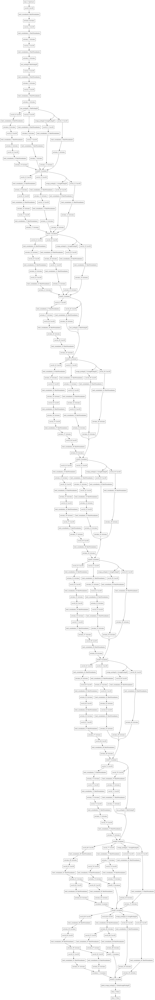

In [0]:
from tensorflow.keras.utils import plot_model

plot_model(inception_model)